In [ ]:
!pip install segmentation_models_pytorch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 6.1 MB/s eta 0:00:00


In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset
from transformers import SegformerForSemanticSegmentation, Trainer, TrainingArguments, get_linear_schedule_with_warmup
from PIL import Image
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt
from torch.optim import AdamW
import segmentation_models_pytorch as smp  # 🔹 добавили SMP
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation, Trainer, TrainingArguments
# -------------------------
# Параметры
# -------------------------
patch_size = 512
stride = 256   # перекрытие патчей
num_classes = 5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.environ["WANDB_DISABLED"] = "true"

batch_size = 16
num_epochs = 200
image_dir = "/content/drive/MyDrive/segmentation/images/"
mask_dir = "/content/drive/MyDrive/segmentation/annotation/"
num_classes = 5
unique_colors = [
    [0,0,0], [0,0,255], [0,255,0], [255,0,0], [255,255,255]
]
class_labels = ["фон", "синие", "зелёные", "красные", "белый"]


In [ ]:
# -------------------------
# 2. Загрузка файлов
# -------------------------
with open("/content/drive/MyDrive/segmentation/training.txt", "r") as f:
    train_files = [line.strip() for line in f.readlines()]
with open("/content/drive/MyDrive/segmentation/testing.txt", "r") as f:
    test_files = [line.strip() for line in f.readlines()]


In [ ]:
# -------------------------
# 5. Предзагрузка изображений и масок
# -------------------------
def load_images_masks(file_list):
    images_mem, masks_mem = [], []
    for file_name in file_list:
        img = np.array(Image.open(os.path.join(image_dir, file_name)).convert("RGB"))
        mask = np.array(Image.open(os.path.join(mask_dir, file_name)))
        mask_class = np.zeros((mask.shape[0], mask.shape[1]), dtype=np.int64)
        for i, color in enumerate(unique_colors):
            mask_class[np.all(mask == color, axis=-1)] = i
        images_mem.append(img)
        masks_mem.append(mask_class)
    return images_mem, masks_mem

train_images_mem, train_masks_mem = load_images_masks(train_files)
test_images_mem, test_masks_mem = load_images_masks(test_files)


In [ ]:
# -------------------------
# Dataset на патчах
# -------------------------
class FundusPatchDatasetMem(Dataset):
    def __init__(self, images_mem, masks_mem, feature_extractor, augment=False):
        self.feature_extractor = feature_extractor
        self.patch_size = patch_size
        self.stride = stride
        self.augment = augment
        self.patches = []

        for img, mask in zip(images_mem, masks_mem):
            h, w, _ = img.shape
            for i in range(0, h - patch_size + 1, stride):
                for j in range(0, w - patch_size + 1, stride):
                    img_patch = img[i:i+patch_size, j:j+patch_size]
                    mask_patch = mask[i:i+patch_size, j:j+patch_size]
                    if img_patch.shape[:2] == (patch_size, patch_size):
                        self.patches.append((img_patch, mask_patch))

    def __len__(self):
        return len(self.patches)

    def __getitem__(self, idx):
        img_patch, mask_patch = self.patches[idx]

        if self.augment:
            if np.random.rand() > 0.5:
                img_patch = np.flip(img_patch, axis=1).copy()
                mask_patch = np.flip(mask_patch, axis=1).copy()
            if np.random.rand() > 0.5:
                img_patch = np.flip(img_patch, axis=0).copy()
                mask_patch = np.flip(mask_patch, axis=0).copy()

        encoding = self.feature_extractor(images=Image.fromarray(img_patch), return_tensors="pt")
        pixel_values = encoding['pixel_values'].squeeze()
        labels = torch.tensor(mask_patch, dtype=torch.long)
        return {"pixel_values": pixel_values, "labels": labels}

In [ ]:
# -------------------------
# Метрики Dice и IoU
# -------------------------
def dice_metric(pred, target, class_idx):
    pred_mask = (pred == class_idx).astype(np.int32)
    true_mask = (target == class_idx).astype(np.int32)
    intersection = np.sum(pred_mask * true_mask)
    union = np.sum(pred_mask) + np.sum(true_mask)
    return 1.0 if union == 0 else 2 * intersection / union

def iou_metric(pred, target, class_idx):
    pred_mask = (pred == class_idx).astype(np.int32)
    true_mask = (target == class_idx).astype(np.int32)
    intersection = np.sum(pred_mask * true_mask)
    union = np.sum(pred_mask) + np.sum(true_mask) - intersection
    return 1.0 if union == 0 else intersection / union


In [ ]:
feature_extractor = SegformerFeatureExtractor(reduce_labels=False)

In [ ]:

feature_extractor = SegformerFeatureExtractor(reduce_labels=False)


# -------------------------
# K-Fold обучение
# -------------------------
kf = KFold(n_splits=5, shuffle=True, random_state=42)
fold_results = []

for fold, (train_idx, val_idx) in enumerate(kf.split(train_images_mem)):
    print(f"\n--- Fold {fold+1} ---")

    # Модель
    model = SegformerForSemanticSegmentation.from_pretrained(
        "nvidia/segformer-b0-finetuned-ade-512-512",
        num_labels=num_classes,
        id2label={i:str(i) for i in range(num_classes)},
        label2id={str(i):i for i in range(num_classes)},
        ignore_mismatched_sizes=True
    ).to(device)

    # Датасеты
    train_ds = FundusPatchDatasetMem([train_images_mem[i] for i in train_idx],
                                     [train_masks_mem[i] for i in train_idx],
                                     feature_extractor,
                                     augment=True)
    val_ds = FundusPatchDatasetMem([train_images_mem[i] for i in val_idx],
                                   [train_masks_mem[i] for i in val_idx],
                                   feature_extractor,
                                   augment=False)

    # Классовые веса для Focal Loss
    all_masks = np.concatenate([m.flatten() for m in [train_masks_mem[i] for i in train_idx]])
    class_counts = np.bincount(all_masks, minlength=num_classes)
    class_weights = 1.0 / (class_counts + 1e-6)
    class_weights = class_weights / class_weights.sum()
    class_weights = torch.tensor(class_weights, dtype=torch.float).to(device)

    # 🔹 Используем SMP FocalLoss
    criterion = smp.losses.FocalLoss(
        mode="multiclass",
        alpha=class_weights,
        gamma=2.0
    )

    # Optimizer + Scheduler
    optimizer = AdamW(model.parameters(), lr=5e-5)
    num_training_steps = (len(train_ds) // batch_size + int(len(train_ds) % batch_size != 0)) * num_epochs
    scheduler = get_linear_schedule_with_warmup(
        optimizer,
        num_warmup_steps=int(0.1*num_training_steps),
        num_training_steps=num_training_steps
    )

    # TrainingArguments
    training_args = TrainingArguments(
        output_dir=f"./segformer-fold{fold+1}",
        per_device_train_batch_size=batch_size,
        learning_rate=5e-5,
        num_train_epochs=num_epochs,
        logging_dir=f"./logs/fold{fold+1}",
        logging_steps=50,
        save_strategy="epoch",
        dataloader_num_workers=4,
        dataloader_pin_memory=True
    )

    # Compute metrics
    def compute_metrics(eval_pred):
        logits, labels = eval_pred
        if logits.shape[2:] != labels.shape[1:]:
            logits = F.interpolate(torch.tensor(logits), size=labels.shape[1:], mode="bilinear", align_corners=False)
            logits = logits.detach().cpu().numpy()
        preds = np.argmax(logits, axis=1)
        dice_per_class = [np.mean([dice_metric(p, l, c) for p, l in zip(preds, labels)]) for c in range(num_classes)]
        iou_per_class = [np.mean([iou_metric(p, l, c) for p, l in zip(preds, labels)]) for c in range(num_classes)]
        return {
            "dice": dice_per_class,
            "iou": iou_per_class,
            "mean_dice": float(np.mean(dice_per_class)),
            "mean_iou": float(np.mean(iou_per_class))
        }

    # Trainer
    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_ds,
        eval_dataset=val_ds,
        tokenizer=feature_extractor,
        compute_metrics=compute_metrics,
        optimizers=(optimizer, scheduler)
    )

    # Обучение
    trainer.train()
    eval_metrics = trainer.evaluate()
    fold_results.append(eval_metrics)
    model.save_pretrained(f"./segformer-fold{fold+1}/best_model")

    # Просмотр первых 3 патчей валидации
    model.eval()
    for i, sample in enumerate(val_ds):
        pixel_values = sample['pixel_values'].unsqueeze(0).to(device)
        labels = sample['labels'].numpy()

        with torch.no_grad():
            outputs = model(pixel_values)
            pred_mask = torch.argmax(outputs.logits, dim=1).squeeze().cpu().numpy()

        if i < 3:
            plt.figure(figsize=(12,4))

            img = sample['pixel_values'].permute(1,2,0).cpu().numpy()
            if img.max() <= 1.0:
                img = (img * 255).astype(np.uint8)

            plt.subplot(1,3,1)
            plt.title("Input")
            plt.imshow(img)
            plt.axis('off')

            plt.subplot(1,3,2)
            plt.title("Ground truth")
            plt.imshow(labels, cmap='tab20', vmin=0, vmax=num_classes-1)
            plt.axis('off')

            plt.subplot(1,3,3)
            plt.title("Prediction")
            plt.imshow(pred_mask, cmap='tab20', vmin=0, vmax=num_classes-1)
            plt.axis('off')

            plt.show()


In [ ]:
import shutil
import zipfile

zip_name = "segformer_folds.zip"
output_root = "./"
# удалим старый архив, если есть
if os.path.exists(zip_name):
    os.remove(zip_name)

with zipfile.ZipFile(zip_name, "w", zipfile.ZIP_DEFLATED) as zipf:
    for fold in range(1, kf.get_n_splits() + 1):
        folder = f"./segformer-fold{fold}/best_model"
        for root, _, files in os.walk(folder):
            for file in files:
                file_path = os.path.join(root, file)
                arcname = os.path.relpath(file_path, start=output_root)  # относительный путь в архиве
                zipf.write(file_path, arcname)

print(f"✅ Все модели сохранены в архив {zip_name}")


In [ ]:
import matplotlib.patches as mpatches

# -------------------------
# Функция для предсказания полного изображения из патчей
# -------------------------
def predict_full_image(model, img, patch_size=512, stride=256):
    h, w, _ = img.shape
    full_probs = np.zeros((h, w, num_classes), dtype=np.float32)
    count_mask = np.zeros((h, w, num_classes), dtype=np.float32)

    for i in range(0, h, stride):
        for j in range(0, w, stride):
            i_end = min(i + patch_size, h)
            j_end = min(j + patch_size, w)
            patch = img[i:i_end, j:j_end]

            encoding = feature_extractor(images=Image.fromarray(patch), return_tensors="pt")
            inputs = {k: v.to(device) for k, v in encoding.items()}

            with torch.no_grad():
                logits = model(**inputs).logits
                # Интерполируем логиты к размеру patch
                logits = F.interpolate(logits, size=(i_end - i, j_end - j), mode="bilinear", align_corners=False)
                probs = torch.softmax(logits, dim=1).squeeze().cpu().numpy().transpose(1,2,0)

            full_probs[i:i_end, j:j_end, :] += probs
            count_mask[i:i_end, j:j_end, :] += 1

    full_probs /= np.maximum(count_mask, 1e-6)
    final_mask = np.argmax(full_probs, axis=-1)
    return final_mask



# -------------------------
# Функция для отображения маски с оригинальными цветами
# -------------------------
def mask_to_rgb(mask, colors):
    h, w = mask.shape
    rgb = np.zeros((h, w, 3), dtype=np.uint8)
    for i, color in enumerate(colors):
        rgb[mask == i] = color
    return rgb

# -------------------------
# Тестирование
# -------------------------
all_dice = []
all_iou = []

for fold in range(5):
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path).to(device)
    model.eval()

    for img, mask_class in zip(test_images_mem, test_masks_mem):
        pred_mask = predict_full_image(model, img, patch_size=patch_size, stride=stride)

        # Конвертируем маски в RGB
        gt_rgb = mask_to_rgb(mask_class, unique_colors)      # unique_colors в [R,G,B] 0-255
        pred_rgb = mask_to_rgb(pred_mask, unique_colors)

        # -------------------------
        # Вычисление метрик
        # -------------------------
        dice_vals = [dice_metric(pred_mask, mask_class, c) for c in range(num_classes)]
        iou_vals = [iou_metric(pred_mask, mask_class, c) for c in range(num_classes)]
        all_dice.append(dice_vals)
        all_iou.append(iou_vals)

        # -------------------------
        # Визуализация
        # -------------------------
        plt.figure(figsize=(15,5))
        plt.subplot(1,3,1)
        plt.title("Image ")
        plt.imshow(img)
        plt.axis("off")

        plt.subplot(1,3,2)
        plt.title("Ground Truth")
        plt.imshow(gt_rgb)
        plt.axis("off")

        plt.subplot(1,3,3)
        plt.title("Predicted")
        plt.imshow(pred_rgb)
        plt.axis("off")
        plt.show()

# -------------------------
# Средние метрики по всему тесту
# -------------------------
all_dice = np.array(all_dice)
all_iou = np.array(all_iou)

for c in range(num_classes):
    print(f"Class {c}: Dice = {all_dice[:,c].mean():.4f}, IoU = {all_iou[:,c].mean():.4f}")

print(f"Mean Dice: {all_dice.mean():.4f}, Mean IoU: {all_iou.mean():.4f}")


In [ ]:
import zipfile
import os

# путь к архиву
zip_path = "segformer_folds.zip"
# куда распаковать
extract_path = "./"

# создаём папку для распаковки, если её нет
os.makedirs(extract_path, exist_ok=True)

# открываем zip-архив и распаковываем
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Архив '{zip_path}' распакован в '{extract_path}'.")

Архив 'segformer_folds.zip' распакован в './'.



=== Testing Fold 1 Model ===


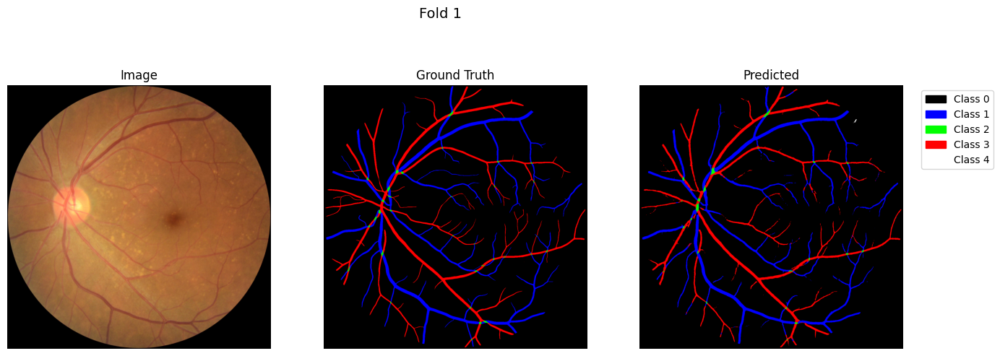

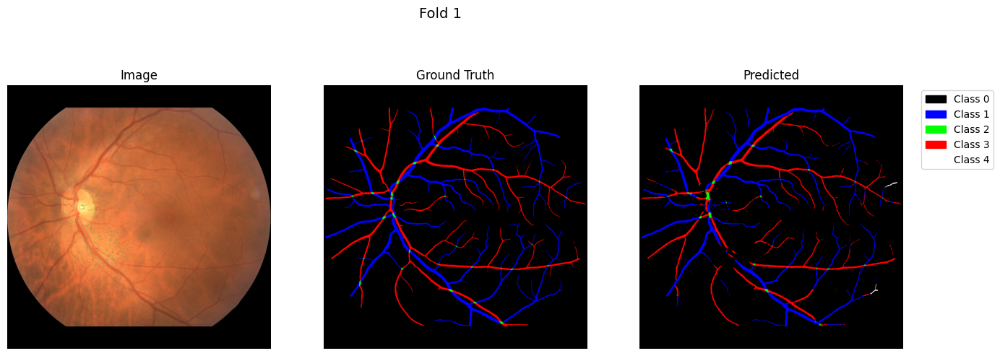

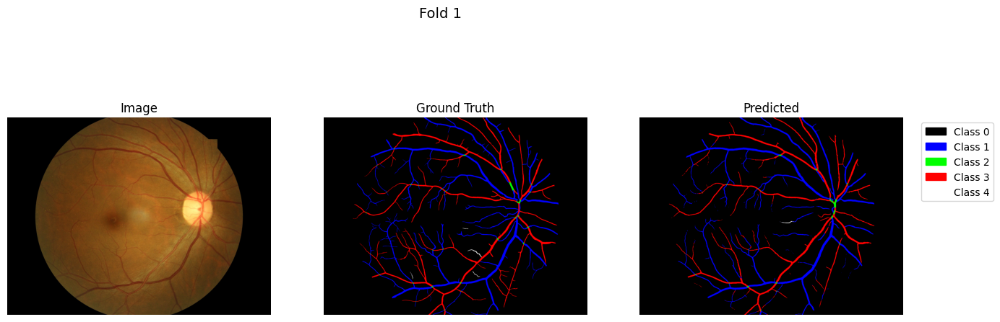

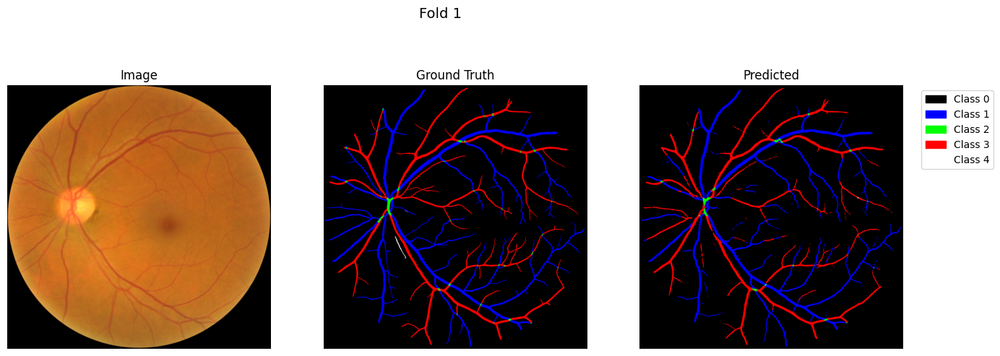

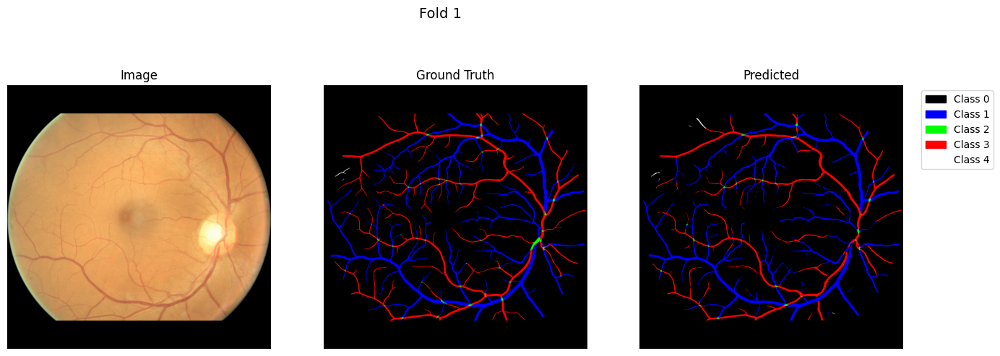

...

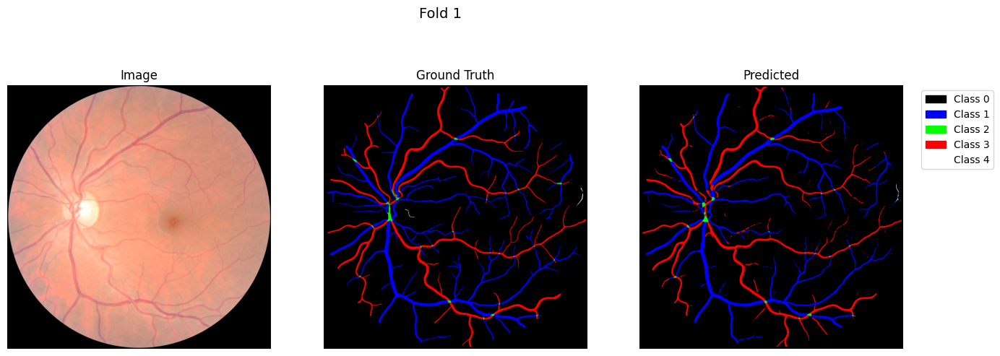

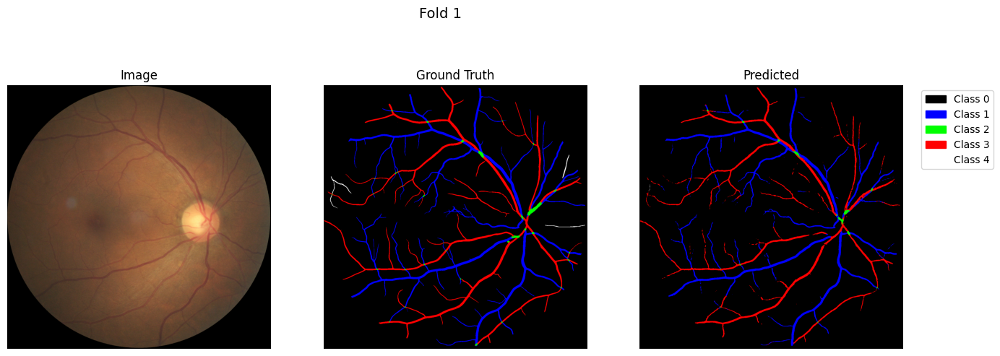

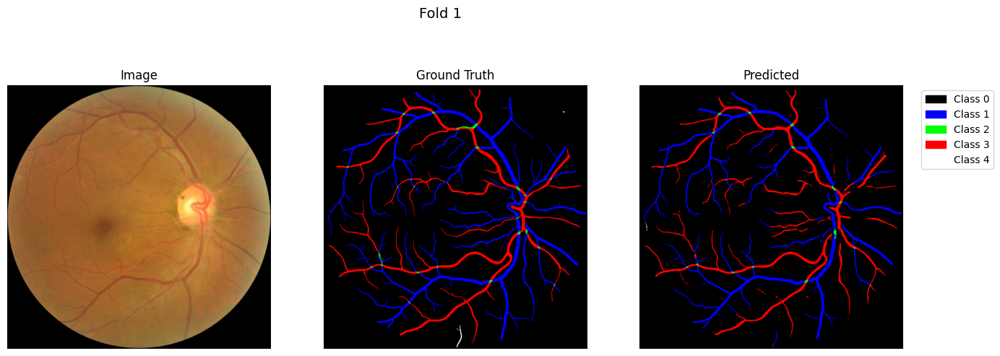

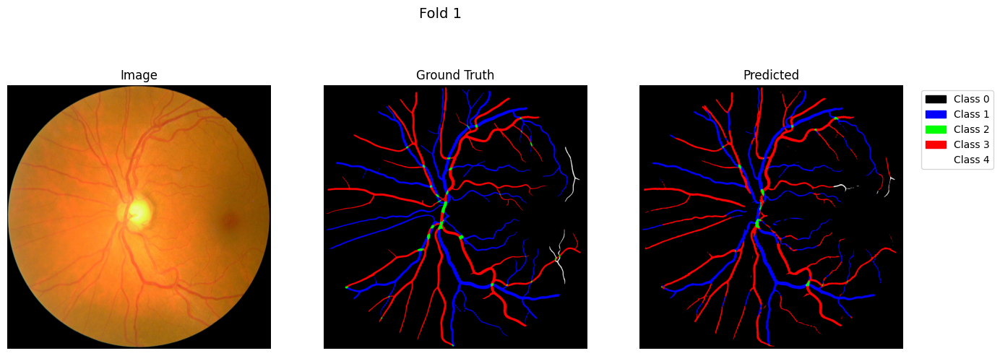

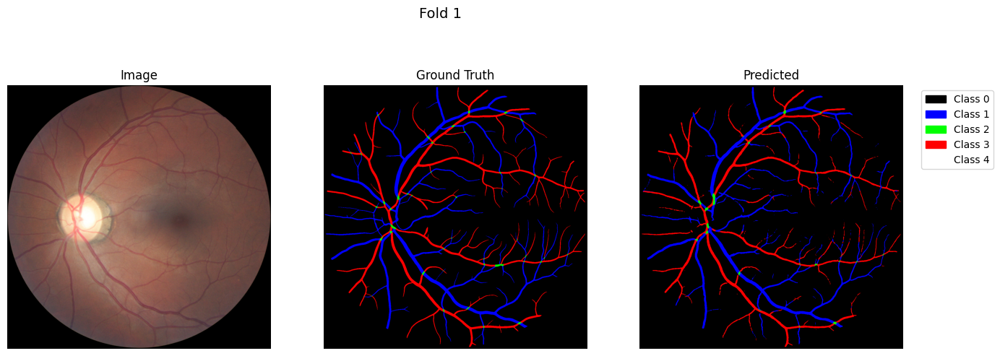


=== Testing Fold 2 Model ===


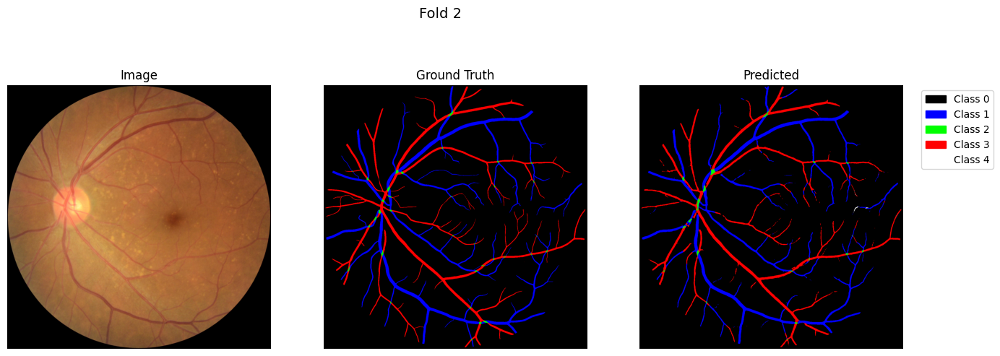

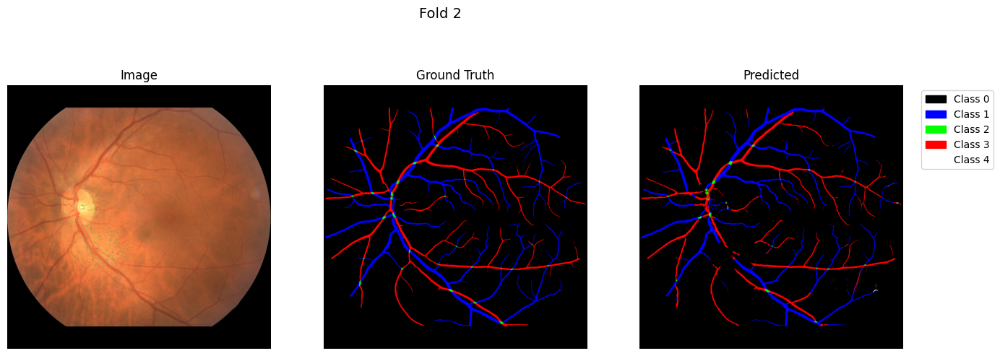

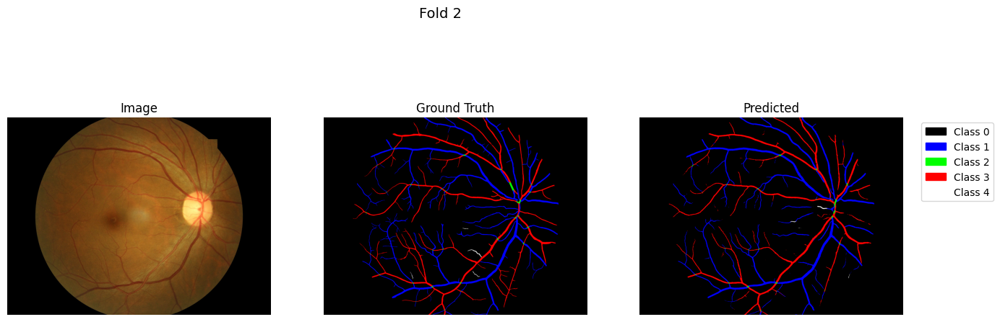

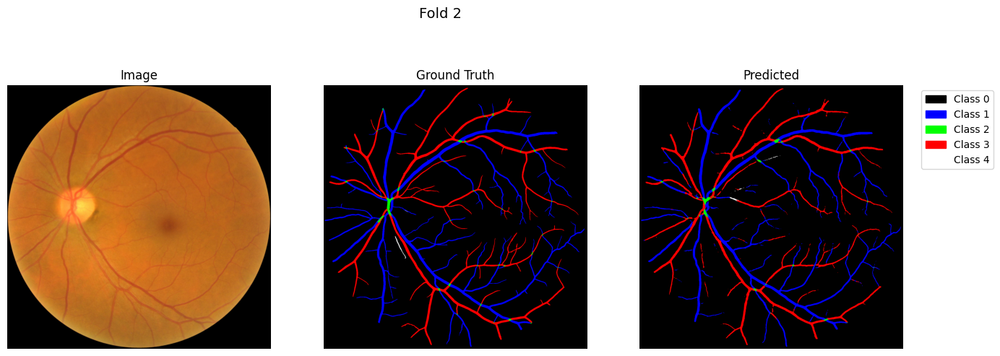

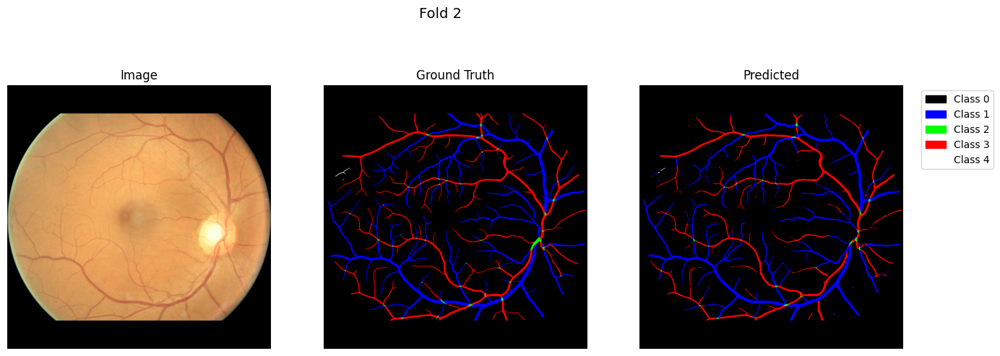

...

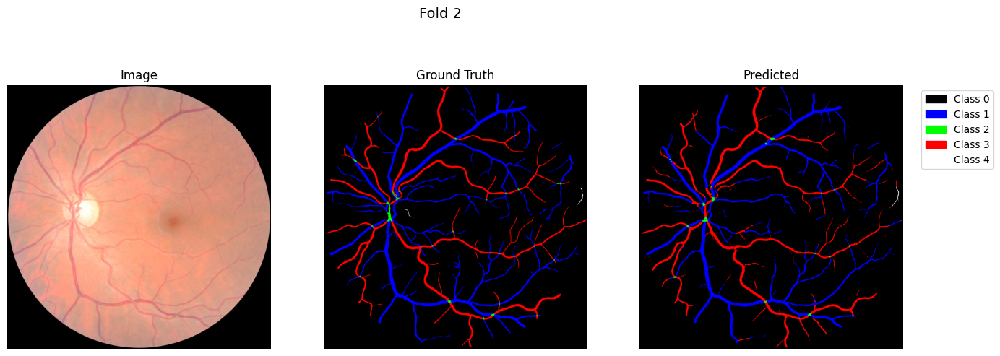

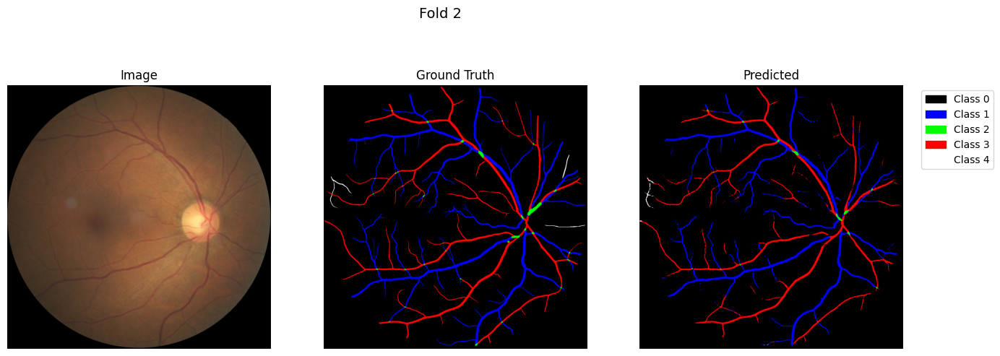

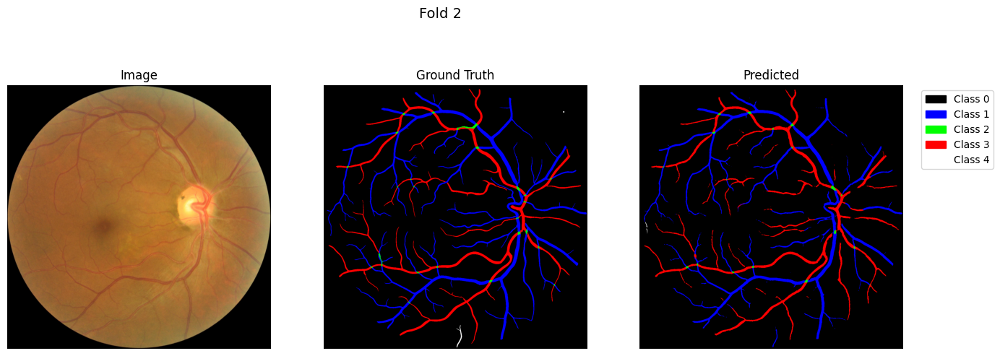

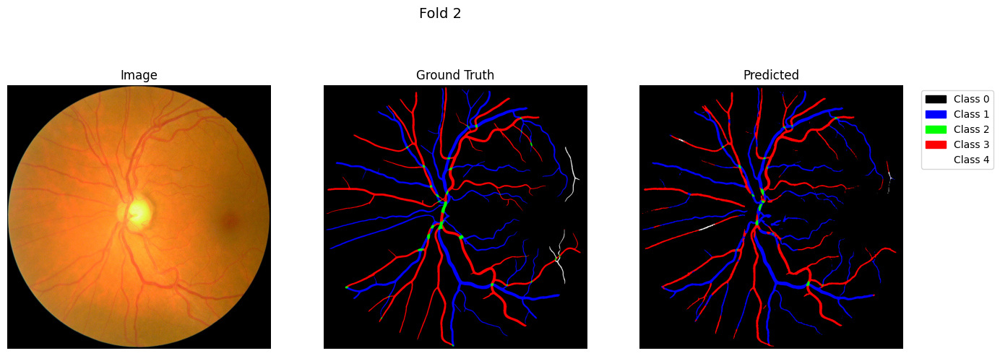

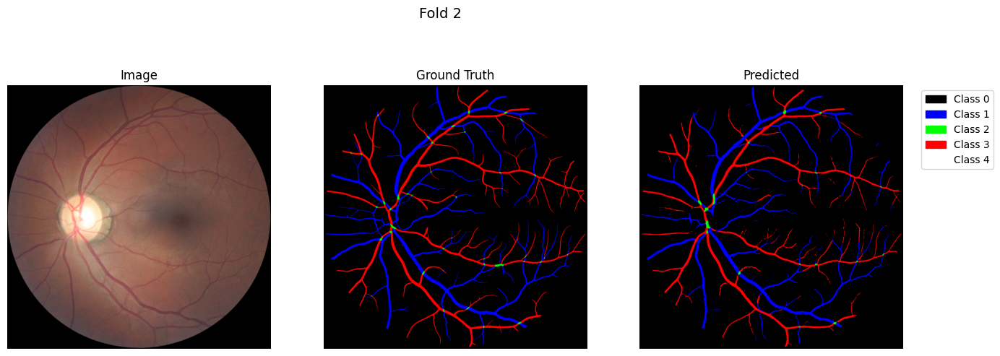


=== Testing Fold 3 Model ===


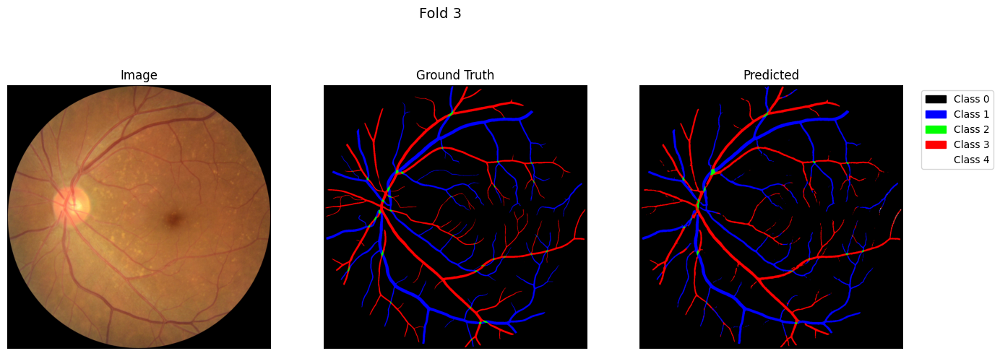

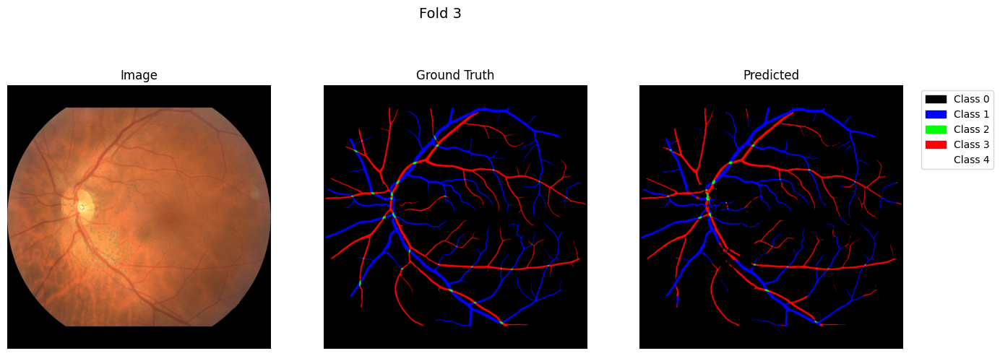

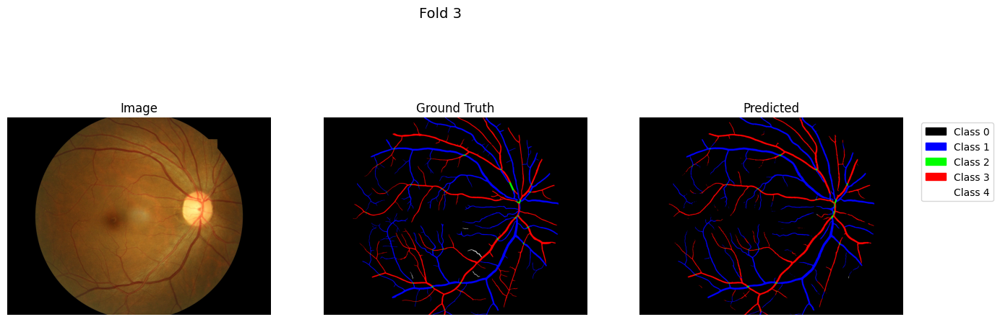

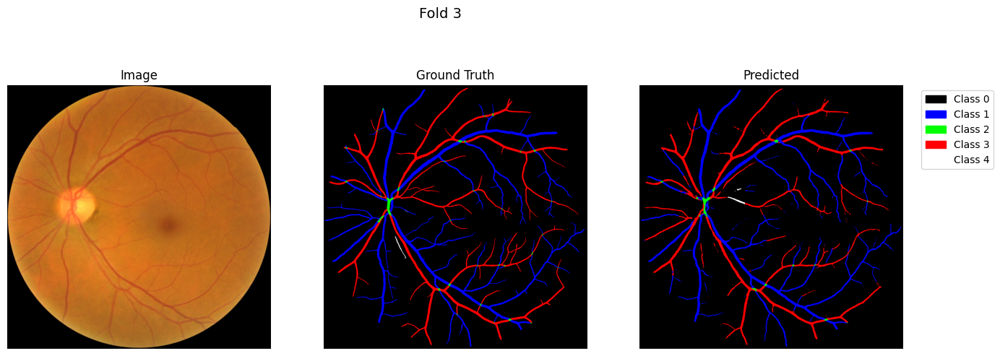

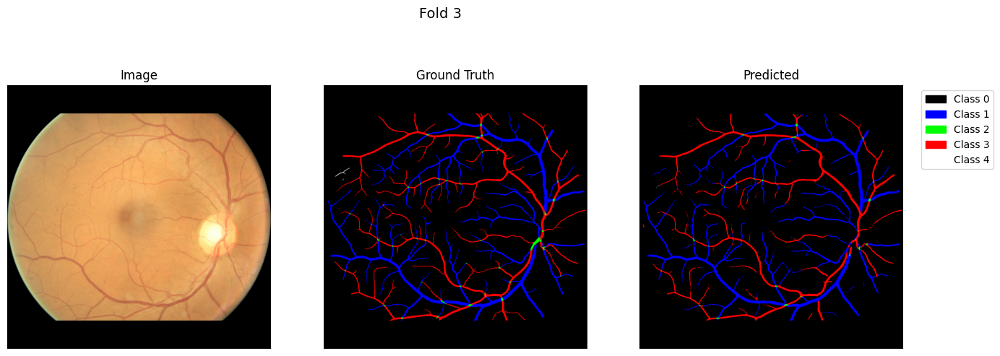

...

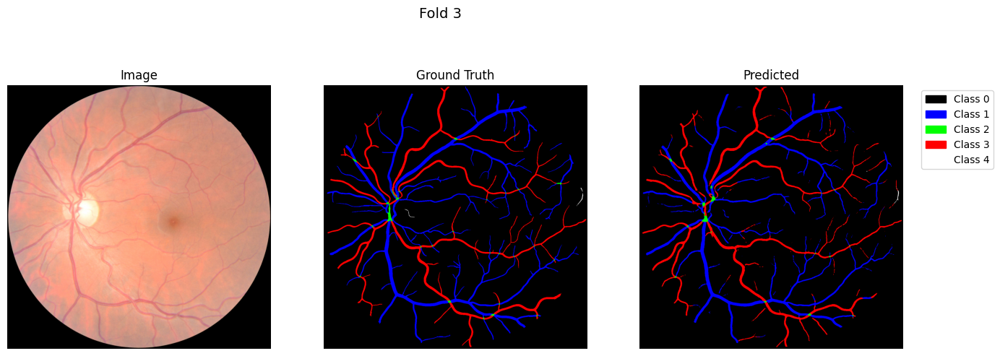

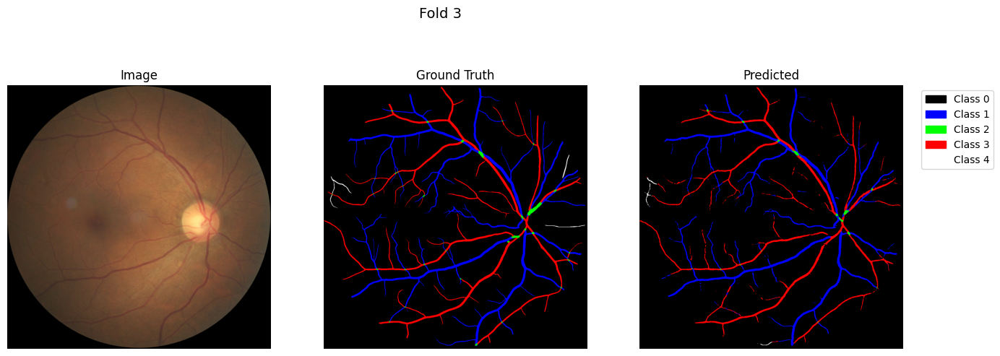

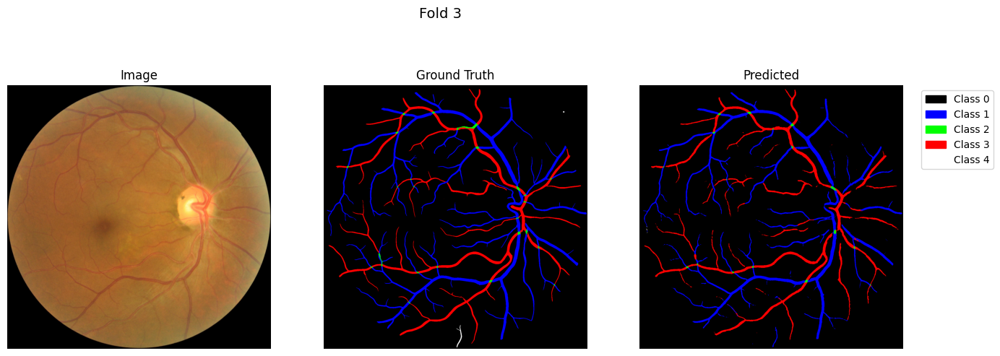

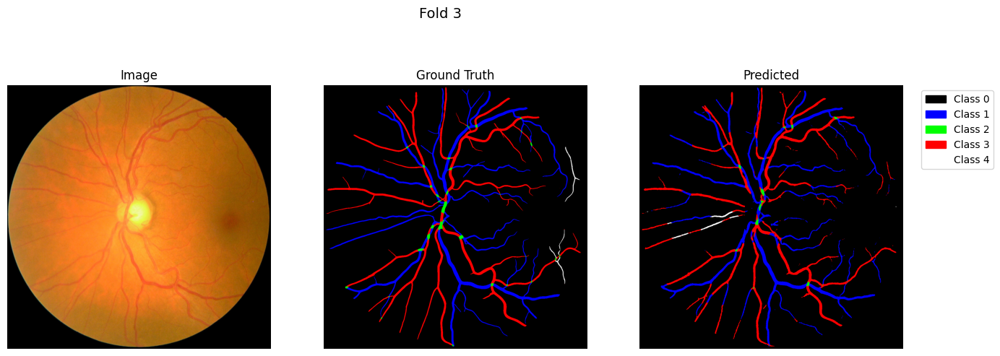

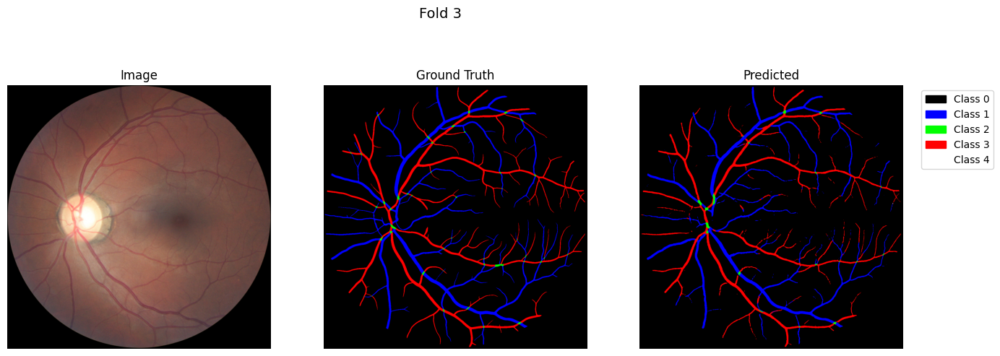


=== Testing Fold 4 Model ===


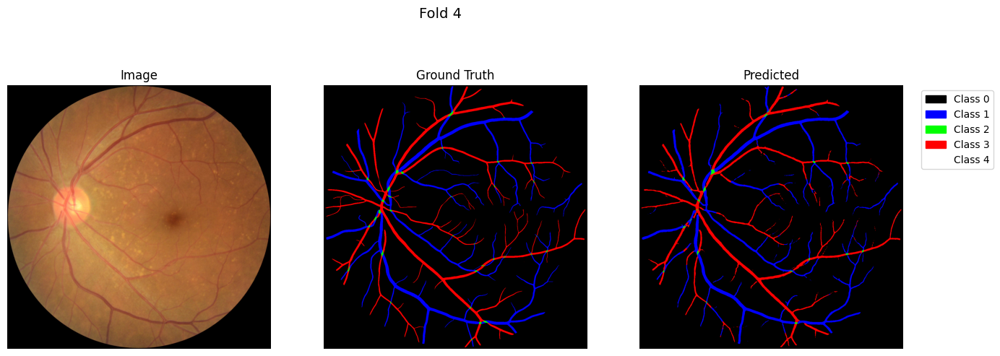

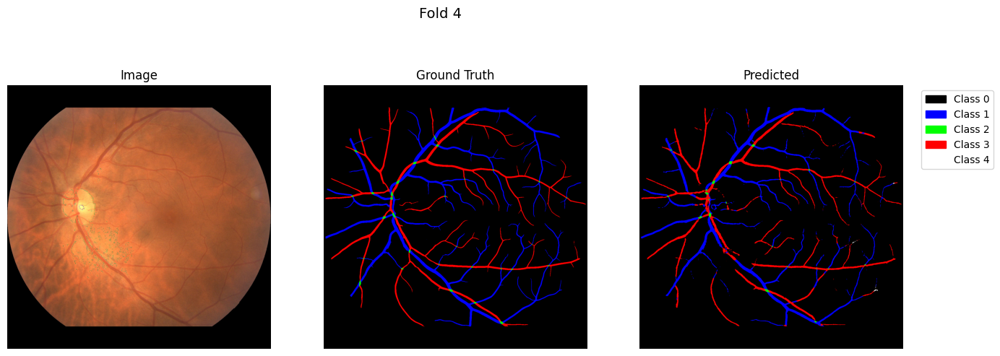

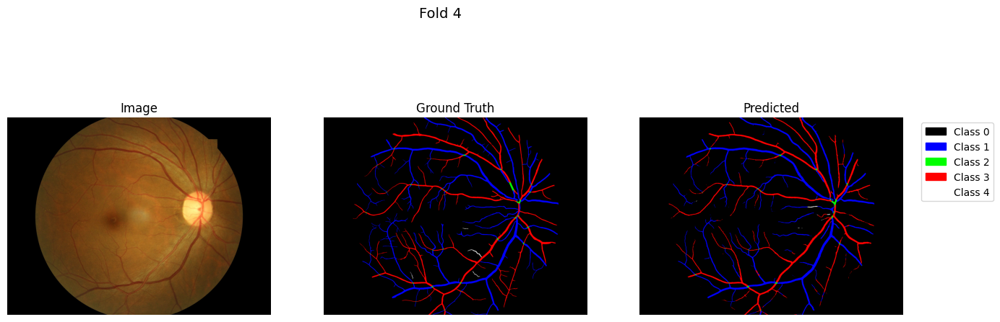

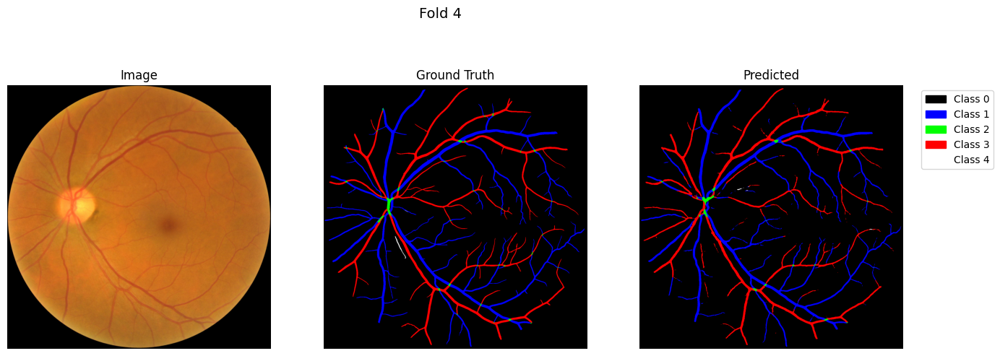

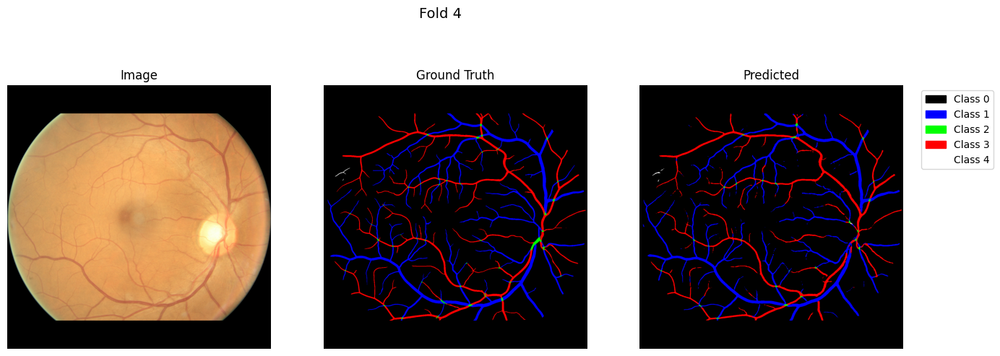

...

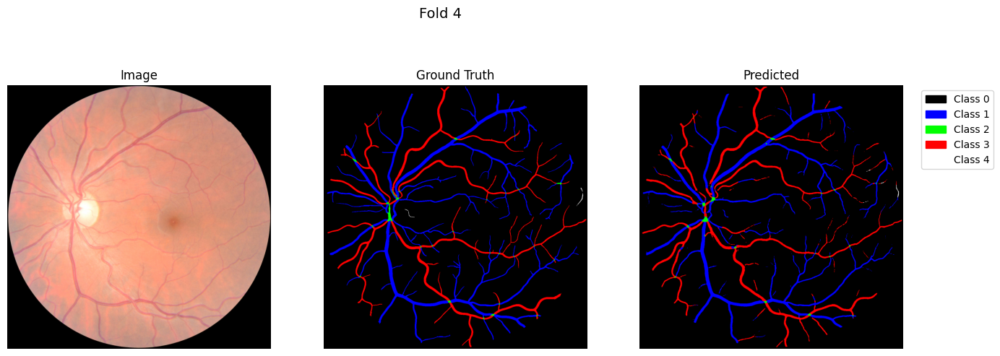

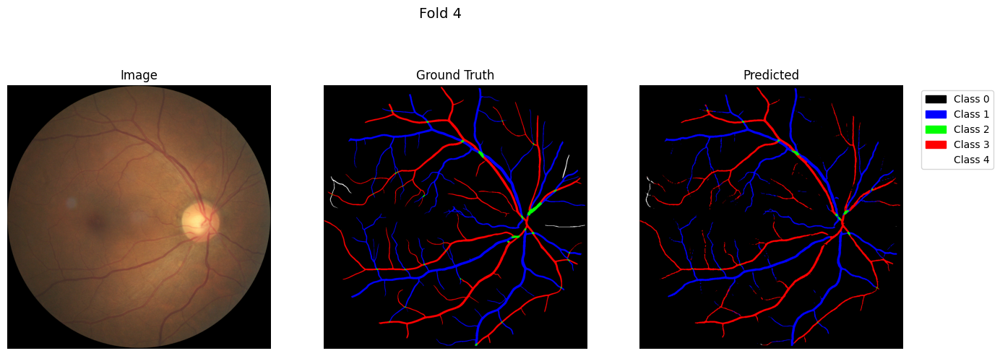

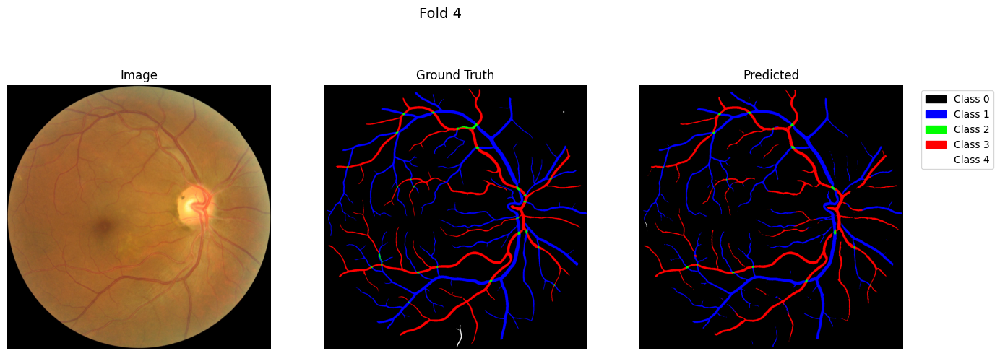

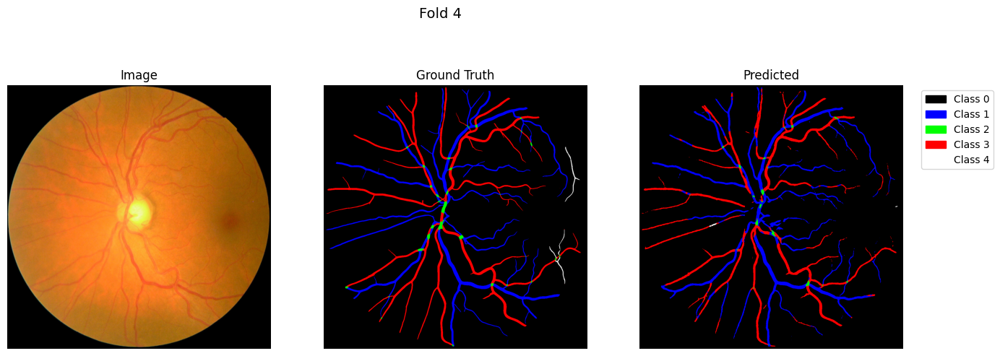

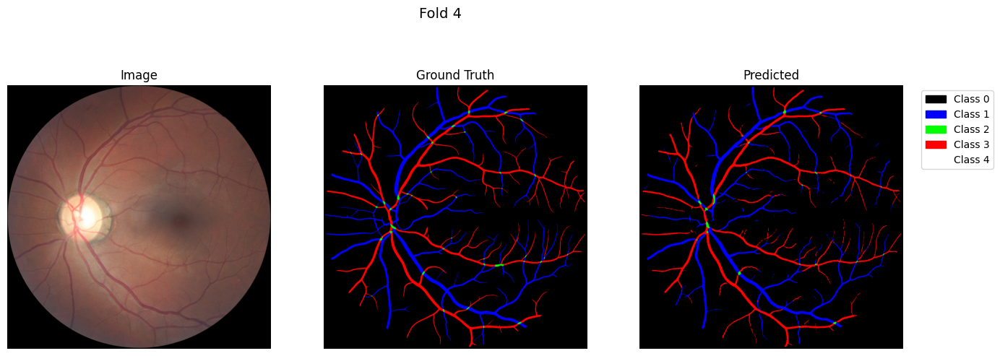


=== Testing Fold 5 Model ===


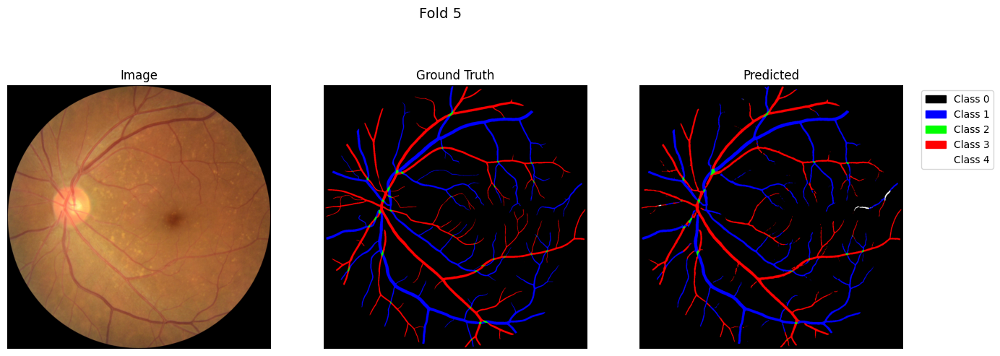

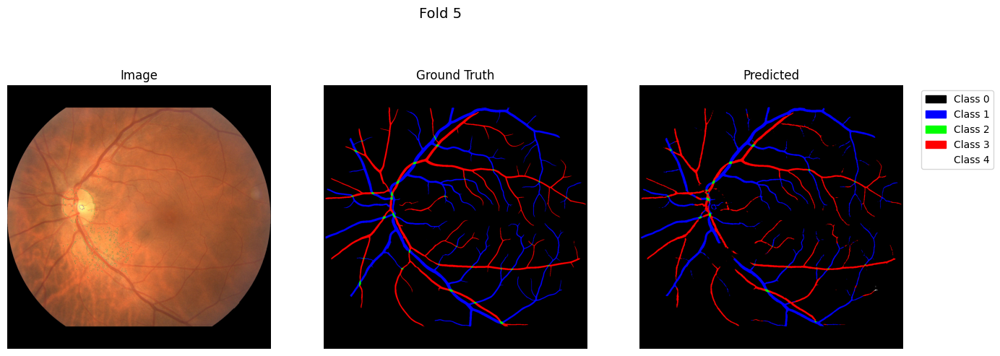

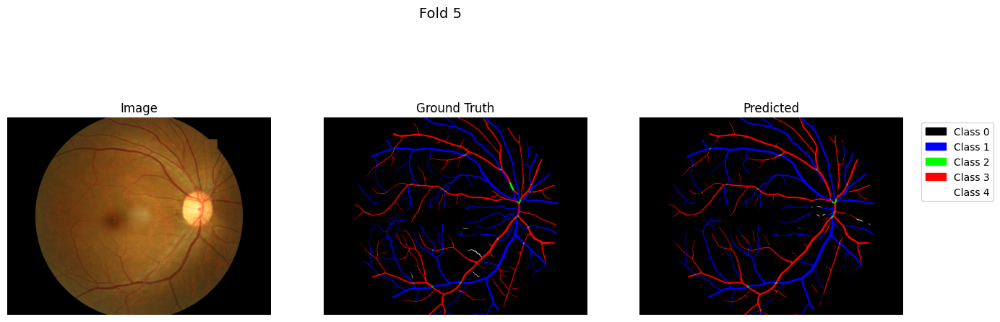

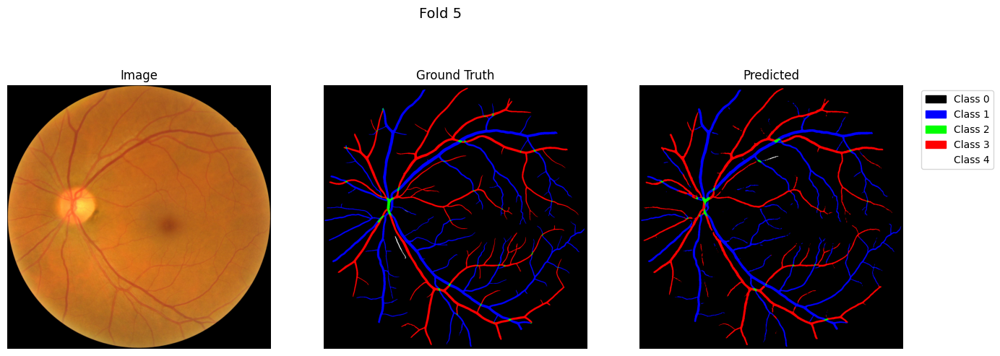

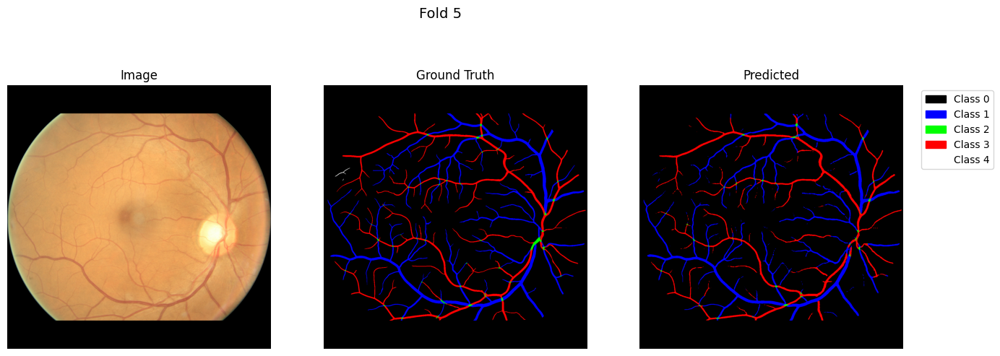

...

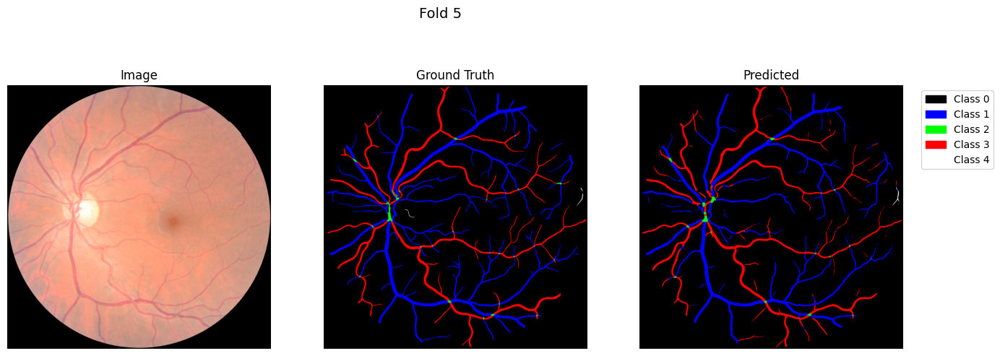

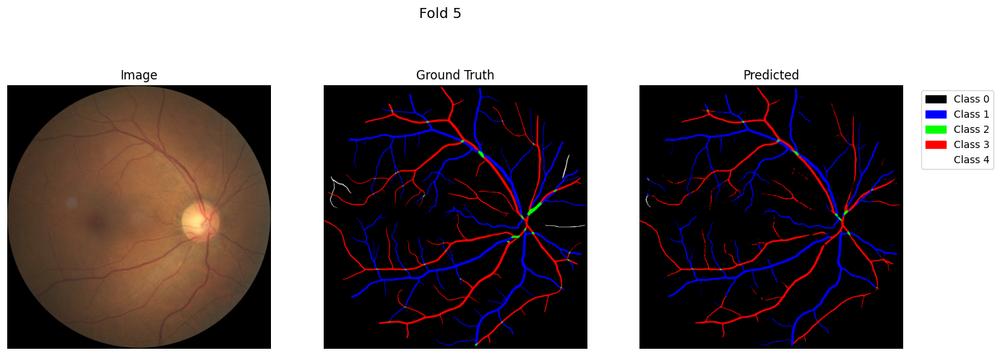

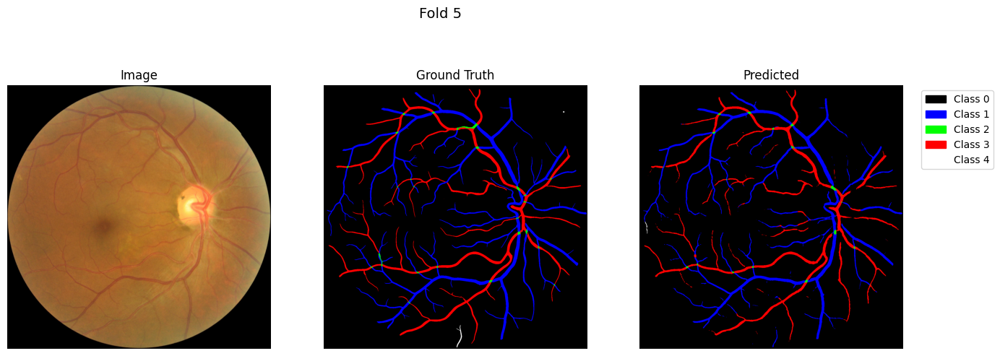

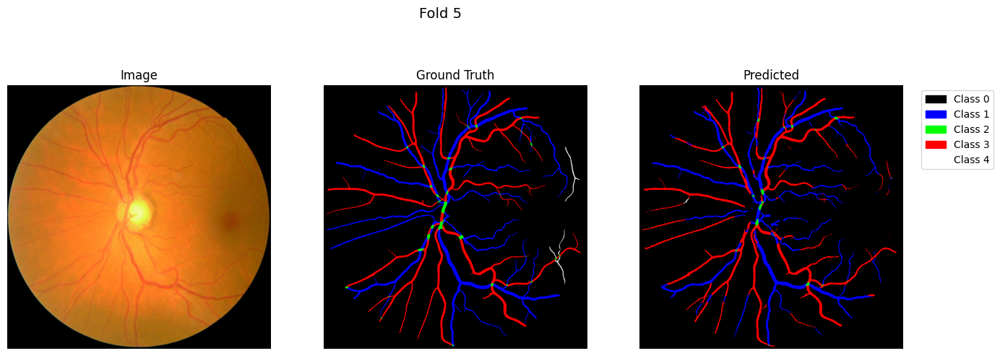

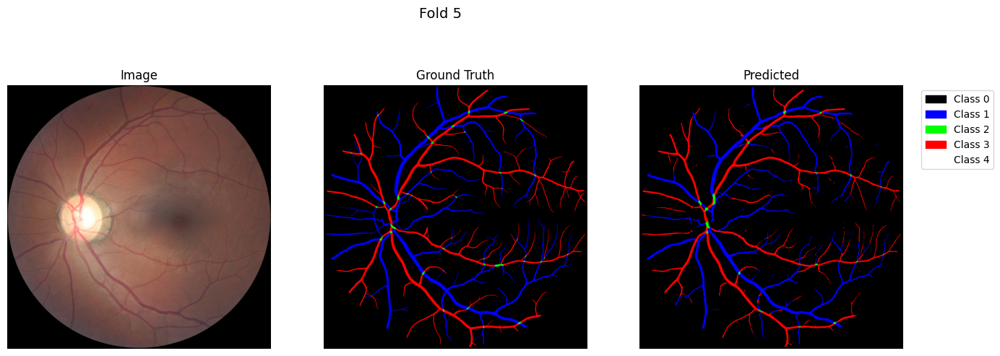


Class 0:
  Dice = 0.9914, IoU = 0.9830
  Precision = 0.9887, Recall = 0.9942, F1 = 0.9914

Class 1:
  Dice = 0.8683, IoU = 0.7685
  Precision = 0.8919, Recall = 0.8477, F1 = 0.8683

Class 2:
  Dice = 0.4904, IoU = 0.3282
  Precision = 0.6009, Recall = 0.4303, F1 = 0.4904

Class 3:
  Dice = 0.8429, IoU = 0.7292
  Precision = 0.8652, Recall = 0.8229, F1 = 0.8429

Class 4:
  Dice = 0.1012, IoU = 0.0772
  Precision = 0.1326, Recall = 0.0499, F1 = 0.0612

Mean Dice: 0.6589, Mean IoU: 0.5773
Pixel Accuracy: 0.9787, Mean Pixel Accuracy: 0.6688


In [ ]:
import matplotlib.patches as mpatches
from sklearn.metrics import confusion_matrix

# -------------------------
# Метрики
# -------------------------
def pixel_accuracy(pred, target):
    return (pred == target).sum() / target.size

def mean_pixel_accuracy(pred, target, num_classes):
    accuracies = []
    for c in range(num_classes):
        mask = (target == c)
        if mask.sum() > 0:
            acc = (pred[mask] == c).sum() / mask.sum()
            accuracies.append(acc)
    return np.mean(accuracies)

def precision_recall_f1(pred, target, num_classes):
    metrics = {}
    for c in range(num_classes):
        tp = np.sum((pred == c) & (target == c))
        fp = np.sum((pred == c) & (target != c))
        fn = np.sum((pred != c) & (target == c))

        precision = tp / (tp + fp + 1e-6)
        recall = tp / (tp + fn + 1e-6)
        f1 = 2 * precision * recall / (precision + recall + 1e-6)

        metrics[c] = (precision, recall, f1)
    return metrics

# -------------------------
# Тестирование
# -------------------------
all_dice, all_iou, all_pa, all_mpa = [], [], [], []
all_precisions, all_recalls, all_f1s = [], [], []

for fold in range(5):
    print(f"\n=== Testing Fold {fold+1} Model ===")
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path).to(device)
    model.eval()

    for img, mask_class in zip(test_images_mem, test_masks_mem):
        pred_mask = predict_full_image(model, img, patch_size=patch_size, stride=stride)

        # Конвертируем маски в RGB
        gt_rgb = mask_to_rgb(mask_class, unique_colors)
        pred_rgb = mask_to_rgb(pred_mask, unique_colors)

        # -------------------------
        # Метрики
        # -------------------------
        dice_vals = [dice_metric(pred_mask, mask_class, c) for c in range(num_classes)]
        iou_vals = [iou_metric(pred_mask, mask_class, c) for c in range(num_classes)]
        pa = pixel_accuracy(pred_mask, mask_class)
        mpa = mean_pixel_accuracy(pred_mask, mask_class, num_classes)
        prf = precision_recall_f1(pred_mask, mask_class, num_classes)

        all_dice.append(dice_vals)
        all_iou.append(iou_vals)
        all_pa.append(pa)
        all_mpa.append(mpa)
        all_precisions.append([prf[c][0] for c in range(num_classes)])
        all_recalls.append([prf[c][1] for c in range(num_classes)])
        all_f1s.append([prf[c][2] for c in range(num_classes)])

        # -------------------------
        # Визуализация
        # -------------------------
        plt.figure(figsize=(16,6))
        plt.suptitle(f"Fold {fold+1}", fontsize=14)

        plt.subplot(1,3,1)
        plt.title("Image")
        plt.imshow(img)
        plt.axis("off")

        plt.subplot(1,3,2)
        plt.title("Ground Truth")
        plt.imshow(gt_rgb)
        plt.axis("off")

        plt.subplot(1,3,3)
        plt.title("Predicted")
        plt.imshow(pred_rgb)
        plt.axis("off")

        # легенда
        patches = [mpatches.Patch(color=np.array(c)/255.0, label=f"Class {i}") for i, c in enumerate(unique_colors)]
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc="upper left")
        plt.show()

# -------------------------
# Средние метрики
# -------------------------
all_dice = np.array(all_dice)
all_iou = np.array(all_iou)
all_precisions = np.array(all_precisions)
all_recalls = np.array(all_recalls)
all_f1s = np.array(all_f1s)

for c in range(num_classes):
    print(f"\nClass {c}:")
    print(f"  Dice = {all_dice[:,c].mean():.4f}, IoU = {all_iou[:,c].mean():.4f}")
    print(f"  Precision = {all_precisions[:,c].mean():.4f}, Recall = {all_recalls[:,c].mean():.4f}, F1 = {all_f1s[:,c].mean():.4f}")

print(f"\nMean Dice: {all_dice.mean():.4f}, Mean IoU: {all_iou.mean():.4f}")
print(f"Pixel Accuracy: {np.mean(all_pa):.4f}, Mean Pixel Accuracy: {np.mean(all_mpa):.4f}")


In [ ]:
import numpy as np
from scipy import stats

def mean_ci(data, confidence=0.95):
    """Среднее и доверительный интервал"""
    n = len(data)
    mean = np.mean(data)
    sem = stats.sem(data)  # стандартная ошибка среднего
    h = sem * stats.t.ppf((1 + confidence) / 2., n-1)
    return mean, mean-h, mean+h

# словарь для хранения результатов
metrics_summary = {}

for name, arr in {
    "Dice": all_dice,
    "IoU": all_iou,
    "Precision": all_precisions,
    "Recall": all_recalls,
    "F1": all_f1s
}.items():
    # усредняем по классам, чтобы был один вектор "по фолдам"
    arr_mean_per_fold = arr.mean(axis=1)  # [num_folds]
    mean, low, high = mean_ci(arr_mean_per_fold)
    metrics_summary[name] = (mean, low, high)

# вывод
print("Метрики с 95% доверительными интервалами:")
for metric, (mean, low, high) in metrics_summary.items():
    print(f"{metric}: {mean:.4f} (95% CI: {low:.4f} – {high:.4f})")


Метрики с 95% доверительными интервалами:
Dice: 0.6589 (95% CI: 0.6490 – 0.6687)
IoU: 0.5773 (95% CI: 0.5677 – 0.5868)
Precision: 0.6959 (95% CI: 0.6837 – 0.7080)
Recall: 0.6290 (95% CI: 0.6222 – 0.6358)
F1: 0.6508 (95% CI: 0.6441 – 0.6576)


In [ ]:
from scipy import stats

def mean_ci(data, confidence=0.95):
    """Среднее и доверительный интервал"""
    n = len(data)
    mean = np.mean(data)
    sem = stats.sem(data)  # стандартная ошибка среднего
    h = sem * stats.t.ppf((1 + confidence) / 2., n-1)
    return mean, mean-h, mean+h

for c in range(num_classes):
    dice_mean, dice_low, dice_high = mean_ci(all_dice[:, c])
    iou_mean, iou_low, iou_high = mean_ci(all_iou[:, c])
    prec_mean, prec_low, prec_high = mean_ci(all_precisions[:, c])
    rec_mean, rec_low, rec_high = mean_ci(all_recalls[:, c])
    f1_mean, f1_low, f1_high = mean_ci(all_f1s[:, c])

    print(f"\nClass {c}:")
    print(f"  Dice = {dice_mean:.4f} (95% CI: {dice_low:.4f} – {dice_high:.4f})")
    print(f"  IoU = {iou_mean:.4f} (95% CI: {iou_low:.4f} – {iou_high:.4f})")
    print(f"  Precision = {prec_mean:.4f} (95% CI: {prec_low:.4f} – {prec_high:.4f})")
    print(f"  Recall = {rec_mean:.4f} (95% CI: {rec_low:.4f} – {rec_high:.4f})")
    print(f"  F1 = {f1_mean:.4f} (95% CI: {f1_low:.4f} – {f1_high:.4f})")



Class 0:
  Dice = 0.9914 (95% CI: 0.9911 – 0.9918)
  IoU = 0.9830 (95% CI: 0.9823 – 0.9838)
  Precision = 0.9887 (95% CI: 0.9882 – 0.9892)
  Recall = 0.9942 (95% CI: 0.9937 – 0.9948)
  F1 = 0.9914 (95% CI: 0.9911 – 0.9918)

Class 1:
  Dice = 0.8683 (95% CI: 0.8622 – 0.8744)
  IoU = 0.7685 (95% CI: 0.7593 – 0.7777)
  Precision = 0.8919 (95% CI: 0.8829 – 0.9009)
  Recall = 0.8477 (95% CI: 0.8402 – 0.8552)
  F1 = 0.8683 (95% CI: 0.8622 – 0.8744)

Class 2:
  Dice = 0.4904 (95% CI: 0.4751 – 0.5057)
  IoU = 0.3282 (95% CI: 0.3149 – 0.3416)
  Precision = 0.6009 (95% CI: 0.5823 – 0.6195)
  Recall = 0.4303 (95% CI: 0.4087 – 0.4519)
  F1 = 0.4904 (95% CI: 0.4751 – 0.5057)

Class 3:
  Dice = 0.8429 (95% CI: 0.8379 – 0.8479)
  IoU = 0.7292 (95% CI: 0.7219 – 0.7366)
  Precision = 0.8652 (95% CI: 0.8579 – 0.8725)
  Recall = 0.8229 (95% CI: 0.8166 – 0.8292)
  F1 = 0.8429 (95% CI: 0.8379 – 0.8479)

Class 4:
  Dice = 0.1012 (95% CI: 0.0563 – 0.1462)
  IoU = 0.0772 (95% CI: 0.0361 – 0.1183)
  Precision

In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap
from transformers import SegformerForSemanticSegmentation

# --- параметры ---
patch_size = 256
stride = 256
green_class = 2
unique_colors = np.array([
    [0,0,0],       # фон
    [0,0,255],     # синие
    [0,255,0],     # зелёные
    [255,0,0],     # красные
    [255,255,255]  # белый
])
cmap = ListedColormap(unique_colors/255.0)

# функция для нарезки патчей
def extract_patches(img, patch_size=256, stride=256):
    patches = []
    positions = []
    h, w = img.shape[:2]
    for y in range(0, h - patch_size + 1, stride):
        for x in range(0, w - patch_size + 1, stride):
            patches.append(img[y:y+patch_size, x:x+patch_size])
            positions.append((x, y))
    return patches, positions

# функция предсказания для одного патча
def predict_patch(model, patch, device="cuda"):
    tensor = torch.tensor(patch/255.0, dtype=torch.float32).permute(2,0,1).unsqueeze(0).to(device)
    with torch.no_grad():
        outputs = model(tensor)
        if isinstance(outputs, dict) and "logits" in outputs:
            outputs = outputs["logits"]
        pred = torch.argmax(outputs, dim=1).squeeze().cpu().numpy()
    return pred

# --- обход по моделям из фолдов ---
device = "cuda" if torch.cuda.is_available() else "cpu"
for fold in range(5):
    print(f"\n=== Testing Fold {fold+1} Model ===")
    model_path = f"./segformer-fold{fold+1}/best_model"
    model = SegformerForSemanticSegmentation.from_pretrained(model_path).to(device)
    model.eval()

    for img_idx, (image, mask) in enumerate(zip(test_images_mem, test_masks_mem)):
        print(f"\nИзображение {img_idx+1}/{len(test_images_mem)}")

        img_patches, _ = extract_patches(image, patch_size, stride)
        mask_patches, _ = extract_patches(mask, patch_size, stride)

        for i, (patch, mask_patch) in enumerate(zip(img_patches, mask_patches)):
            pred_patch = predict_patch(model, patch, device)

            # проверяем наличие зелёного
            # проверяем наличие зелёного
            if (pred_patch == green_class).any() or (mask_patch == green_class).any():
                plt.figure(figsize=(12,4))

                # Оригинал
                plt.subplot(1,3,1)
                plt.imshow(patch)
                plt.title("Оригинал")
                plt.axis("off")

                # GT маска
                plt.subplot(1,3,2)
                plt.imshow(mask_patch, cmap=cmap, vmin=0, vmax=len(unique_colors)-1)
                plt.title("GT маска")
                plt.axis("off")

                # Предсказание
                plt.subplot(1,3,3)
                plt.imshow(pred_patch, cmap=cmap, vmin=0, vmax=len(unique_colors)-1)
                plt.title("Предсказание")
                plt.axis("off")

                plt.show()

